# AIRBNB LISTINGS BANGKOK ANALYSIS 2012-2022

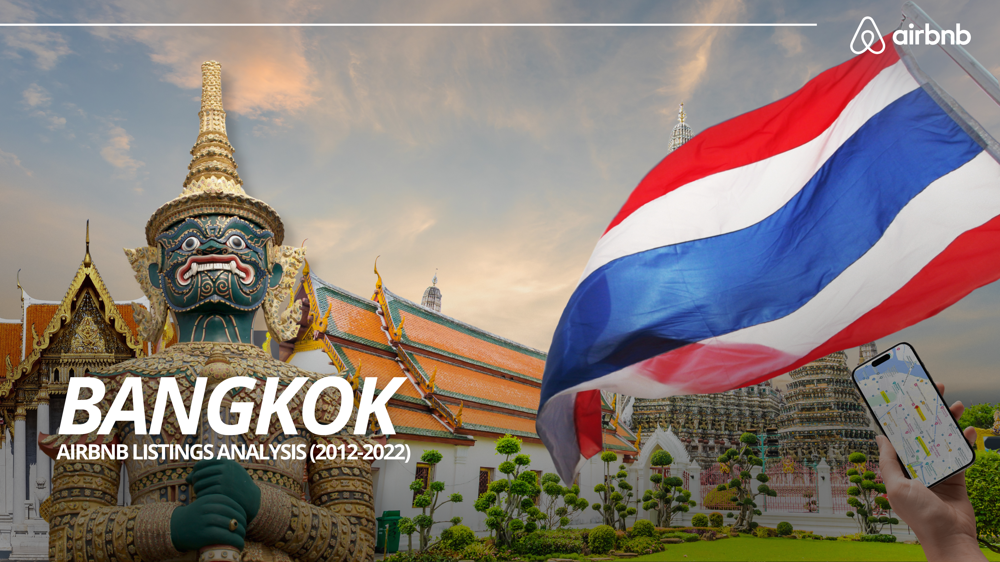

## Business Understanding

Airbnb, a global platform for vacation rentals and short-term accommodations, has been steadily growing its presence in Bangkok since 2012. As one of the most visited cities in Asia, Bangkok offers a diverse rental market where guests choose between room types, price points, and booking flexibility.

As the Airbnb market matures, understanding what makes listings successful — such as pricing strategy, room configuration, and booking requirements — is critical. These factors affect guest satisfaction, review volume, and occupancy rates, all of which are important for both hosts and the platform.

At the same time, shifts in traveler preferences post-COVID and increased competition among hosts mean data-driven insights are more essential than ever. This project aims to uncover which listing traits drive performance and guest engagement.

## Problem Statement

Airbnb hosts in Bangkok face a saturated and evolving market. Without a clear understanding of which listing characteristics (like minimum night stays or room type) influence guest behavior and reviews, they risk losing competitiveness or misaligning with traveler expectations.

Likewise, Airbnb itself and local tourism stakeholders lack granular visibility into how listing formats and booking policies affect platform engagement. This limits their ability to guide hosts, optimize platform performance, or develop effective regional strategies.

Therefore at least 2 questions needs to be answered:
1. What is the most common minimum night requirement among listings, and how does it affect the number of reviews?
2. How do different room types (Entire home/apt, Private room, etc.) compare in terms of average price and reviews?

## Goal

Analyze Airbnb listing characteristics in Bangkok to identify which factors things such as room type and minimum night requirement, influence review frequency and listing popularity.

This analysis aims to:
- Help Airbnb hosts make informed choices about booking flexibility, room format, and pricing.
- Support Airbnb’s regional team in identifying listing configurations that drive higher engagement.
- Offer insights to local tourism authorities interested in how rental structure impacts guest activity and satisfaction.
    
## Analytical Approach

### 1. Room Type Performance
+ Group listings by `room_type`.
+ Calculate average price and average number of reviews per room type.
+ Identify which room types deliver better value or guest satisfaction.
     
### 2. Minimum Night Policy Impact
+ Identify the most common minimum_nights values.
+ Analyze how different minimum night requirements affect `number_of_reviews`.
+ Detect patterns linking booking flexibility with review volume.

## Stakeholder
1. Airbnb Regional Operations Team
2. Local Government (Tourism Authority of Thailand (TAT)
3. Airbnb Hosts

## **Read Data**

In [74]:
import pandas as pd
pd.set_option('display.max_rows', 200)
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
import missingno as msno
import warnings
warnings.filterwarnings("ignore")

## **Airbnb Listings Bangkok Data Dictionary**

- `id`: Airbnb's unique identifier for the listing.
- `name`: Name of the listing.
- `host_id`: Airbnb's unique identifier for the host/user.
- `host_name`: Name of the host. Usually, just the first name(s).
- `neighbourhood`: The neighborhood is geocoded using the latitude and
longitude against neighborhoods as defined by open or public
digital shapefiles.
- `latitude`: Uses the World Geodetic System (WGS84) projection for
latitude and longitude.
- `longitude`: Uses the World Geodetic System (WGS84) projection for
latitude and longitude.
- `room_type`: All homes are grouped into the following three room types:
  * Entire home/apt        
  * Private room            
  * Shared room
- `price`: Daily price in local currency. 
- `minimum_nights`: The minimum number of night stays for the listing
- `number_of_reviews`: The number of reviews the listing has.
- `last_review`: The date of the last/newest review.
- `reviews_per_month`: Average number of reviews for each property each month.
- `calculated_host_listing_count`: The number of listings the host has in the current scrape in
the city/region geography.
- `availability_365`: Property availability for 1 calendar year (in days).
- `numbers_of_reviews_ltm`: The number of reviews the listing has (in the last 12 months).

In [77]:
df=pd.read_csv('Airbnb Listings Bangkok.csv')
display(df.head(),df.tail())

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,NaN,NaN,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,NaN,NaN,1,365,0
3,3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,NaN,NaN,3,365,0


,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
15849,15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,NaN,NaN,1,362,0
15850,15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShoping...,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,NaN,NaN,14,365,0
15851,15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,NaN,NaN,14,365,0
15852,15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,NaN,NaN,14,365,0
15853,15853,790476492384199044,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.752960,100.540820,Private room,1214,1,0,NaN,NaN,14,365,0


## **Data Understanding and Cleaning**

In [80]:
# To check on the dataset, by looking at the number of indexes & rows, the number of columns, the number of non-null and null data, and the data type of each column.
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      15854 non-null  int64  
 1   id                              15854 non-null  int64  
 2   name                            15846 non-null  object 
 3   host_id                         15854 non-null  int64  
 4   host_name                       15853 non-null  object 
 5   neighbourhood                   15854 non-null  object 
 6   latitude                        15854 non-null  float64
 7   longitude                       15854 non-null  float64
 8   room_type                       15854 non-null  object 
 9   price                           15854 non-null  int64  
 10  minimum_nights                  15854 non-null  int64  
 11  number_of_reviews               15854 non-null  int64  
 12  last_review                     

In [82]:
# To check missing values on each columns
df.isna().sum()

Unnamed: 0                           0
id                                   0
name                                 8
host_id                              0
host_name                            1
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       5790
reviews_per_month                 5790
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
dtype: int64

In [84]:
df.nunique()

Unnamed: 0                        15854
id                                15854
name                              14794
host_id                            6659
host_name                          5312
neighbourhood                        50
latitude                           9606
longitude                         10224
room_type                             4
price                              3040
minimum_nights                       86
number_of_reviews                   298
last_review                        1669
reviews_per_month                   513
calculated_host_listings_count       50
availability_365                    366
number_of_reviews_ltm                85
dtype: int64

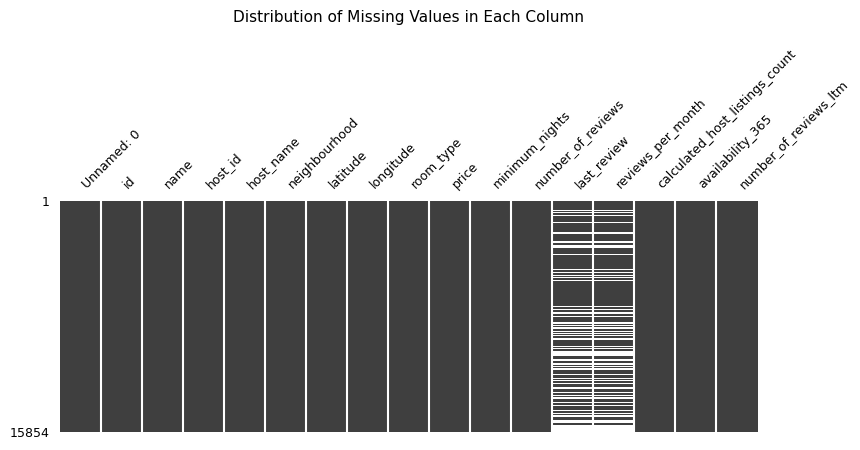

In [86]:
msno.matrix(df, sparkline=False, figsize=(9,3), fontsize=11)
plt.title('Distribution of Missing Values in Each Column\n', fontsize=11, loc='center')
plt.yticks(fontsize=9)
plt.xticks(fontsize=9)
plt.show()

In [88]:
display(df.describe(), df.describe(include='object'))

,Unnamed: 0,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,15854.000000,1.585400e+04,1.585400e+04,15854.000000,15854.000000,1.585400e+04,15854.000000,15854.000000,10064.000000,15854.000000,15854.000000,15854.000000
mean,7926.500000,1.579397e+17,1.541058e+08,13.745144,100.559903,3.217704e+03,15.292355,16.654157,0.813145,13.889618,244.378643,3.481519
std,4576.799919,2.946015e+17,1.318726e+08,0.043040,0.050911,2.497212e+04,50.815020,40.613331,1.090196,30.269848,125.843224,8.916937
min,0.000000,2.793400e+04,5.892000e+04,13.527300,100.329550,0.000000e+00,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000
25%,3963.250000,2.104509e+07,3.974431e+07,13.720090,100.529690,9.000000e+02,1.000000,0.000000,0.120000,1.000000,138.000000,0.000000
50%,7926.500000,3.503734e+07,1.224556e+08,13.738490,100.561415,1.429000e+03,1.000000,2.000000,0.435000,4.000000,309.000000,0.000000
75%,11889.750000,5.256154e+07,2.390547e+08,13.759497,100.585150,2.429000e+03,7.000000,13.000000,1.060000,13.000000,360.000000,3.000000
max,15853.000000,7.908162e+17,4.926659e+08,13.953540,100.923440,1.100000e+06,1125.000000,1224.000000,19.130000,228.000000,365.000000,325.000000


,name,host_name,neighbourhood,room_type,last_review
count,15846,15853,15854,15854,10064
unique,14794,5312,50,4,1669
top,New! La Chada Night Market studio 2PPL near MRT,Curry,Vadhana,Entire home/apt,2022-12-11
freq,45,228,2153,8912,189


### Dropping duplicate index column 'Unnamed: 0' and columns containing null values

In [91]:
df.drop(columns=['Unnamed: 0'], inplace=True)
df.dropna(subset=['name', 'host_name'], inplace = True)

In [93]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15845 entries, 0 to 15853
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              15845 non-null  int64  
 1   name                            15845 non-null  object 
 2   host_id                         15845 non-null  int64  
 3   host_name                       15845 non-null  object 
 4   neighbourhood                   15845 non-null  object 
 5   latitude                        15845 non-null  float64
 6   longitude                       15845 non-null  float64
 7   room_type                       15845 non-null  object 
 8   price                           15845 non-null  int64  
 9   minimum_nights                  15845 non-null  int64  
 10  number_of_reviews               15845 non-null  int64  
 11  last_review                     10061 non-null  object 
 12  reviews_per_month               10061

In [95]:
# To check duplicate in general
duplicate_rows = df[df.duplicated()]
pd.DataFrame(duplicate_rows)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm


In [97]:
# To see duplicate based on selected key columns (Host within the same location)
df[df.duplicated(subset=['host_id', 'latitude', 'longitude'])] 

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
73,385130,❂Citycenter✔Subway station✔Private Bathroom4Ai...,1927968,Evan,Sathon,13.720620,100.54707,Entire home/apt,800,1,396,2020-04-30,3.02,37,361,0
80,393066,✺✺99 feet in the sky✺✺,1927968,Evan,Sathon,13.720620,100.54707,Entire home/apt,829,1,430,2022-10-01,3.39,37,334,10
89,413824,❂100% Private&Central Light EnSuite,1927968,Evan,Sathon,13.720620,100.54707,Entire home/apt,800,1,325,2020-03-14,2.67,37,358,0
122,580270,✴✴Colorful Room with Soaring Views in Center B...,1927968,Evan,Sathon,13.720620,100.54707,Entire home/apt,707,1,93,2022-11-25,0.95,37,346,11
208,2294502,✭✭✭✭Cozy Hideawy in BKK Center near MRT Lumpin...,1927968,Evan,Sathon,13.720620,100.54707,Entire home/apt,609,1,156,2022-11-20,1.45,37,312,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15826,790259260349098761,4 Beds in Mix Dormitory Room,340188343,Rachan,Vadhana,13.740168,100.55632,Shared room,1821,1,0,NaN,NaN,14,365,0
15827,790264226712277949,5 Beds in Mix Dormitory Room,340188343,Rachan,Vadhana,13.740168,100.55632,Shared room,2276,1,0,NaN,NaN,14,365,0
15828,790266011396665923,1 Bed in Mix Dormitory Room,340188343,Rachan,Vadhana,13.740168,100.55632,Shared room,455,1,0,NaN,NaN,14,365,0
15829,790278230325843023,Family Room for 4 People,340188343,Rachan,Vadhana,13.740168,100.55632,Private room,2237,1,0,NaN,NaN,14,360,0


In [99]:
listItem = []
for col in df.columns:
    unique_vals = df[col].unique()
    listItem.append([col, df[col].nunique(), unique_vals])

tabel1Desc = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'],
                          data=listItem)
tabel1Desc

,Column Name,Number of Unique,Unique Sample
0,id,15845,"[27934, 27979, 28745, 35780, 941865, 1704776, ..."
1,name,14793,"[Nice room with superb city view, Easy going l..."
2,host_id,6651,"[120437, 120541, 123784, 153730, 610315, 21296..."
3,host_name,5306,"[Nuttee, Emy, Familyroom, Sirilak, Kasem, Wimo..."
4,neighbourhood,50,"[Ratchathewi, Bang Na, Bang Kapi, Din Daeng, B..."
5,latitude,9602,"[13.75983, 13.66818, 13.75232, 13.78823, 13.76..."
6,longitude,10222,"[100.54134, 100.61674, 100.62402, 100.57256, 1..."
7,room_type,4,"[Entire home/apt, Private room, Hotel room, Sh..."
8,price,3040,"[1905, 1316, 800, 1286, 1000, 1558, 1461, 700,..."
9,minimum_nights,86,"[3, 1, 60, 7, 250, 2, 15, 30, 28, 21, 27, 4, 1..."


Insights:
 - The Airbnb Listings Bangkok dataset contains 16 columns and 15,854 rows.
 - Several `columns—name`, `host_name`, `last_review`, and `reviews_per_month` contain missing values (NaN).
 - The `last_revie`w and `reviews_per_month` columns have around 5,790 missing entries, likely because those listings have never been reviewed.
 - The `id` and `host_id` columns are unique identifiers for each listing and host. These columns are not relevant for statistical analysis, so they can be dropped or used as indices.
 - The price column contains a minimum value of 0, which is not a valid rental price—this should be cleaned or filtered out.
 - The `minimum_nights` column includes extreme values up to 1125 nights. These are likely outliers and should be investigated further as they can skew the average.
 - The `room_type` column contains 4 unique categories, with ‘Entire home/apt’ being the most common (8,912 out of 15,854).
 - The `neighbourhood` column includes 50 different areas within Bangkok, with Vadhana being the area with the highest number of listings.
 - The `reviews_per_month` column is numerical but only has data for about 63% of the rows—this feature is only relevant for listings that have received reviews.
 - The `name` and `host_name` columns contain many unique values (almost as many as the number of rows), so they are not suitable for aggregate analysis.
 - No duplicate rows were found after checking with `df.duplicated()`.
 - This dataset includes several important features for further analysis, such as:
   - `price` (rental price)
   - `availability_365` (number of available days in a year)
   - `number_of_reviews`, `number_of_reviews_ltm` (total reviews and reviews in the last 12 months)
   - `room_type`, `neighbourhood` (property type and location)

In [102]:
def scan_columns(df):
    for col in df.columns:
        print(f"\n=== {col} ===")
        print("Type:", df[col].dtype)
        print("Unique count:", df[col].nunique())
        print("Null values:", df[col].isnull().sum())
        if df[col].dtype == 'object':
            print("Top 5 Unique Values:", df[col].value_counts(dropna=False).head())
        else:
            print(df[col].describe())

In [104]:
scan_columns(df)


=== id ===
Type: int64
Unique count: 15845
Null values: 0
count    1.584500e+04
mean     1.580294e+17
std      2.946611e+17
min      2.793400e+04
25%      2.104514e+07
50%      3.505717e+07
75%      5.258780e+07
max      7.908162e+17
Name: id, dtype: float64

=== name ===
Type: object
Unique count: 14793
Null values: 0
Top 5 Unique Values: name
New!  La Chada Night Market studio 2PPL near MRT      45
30days! AirportLink Sukhumvit NANA MaxValu 2BR(4P)    35
New!  La Chada Night Market 1BR 2PPL near MRT         35
New! Gateway/ Bangkok University 1BR 2PPL near BTS    29
30days!  Sukhumvit NANA spacious 1BR 2PPL near BTS    25
Name: count, dtype: int64

=== host_id ===
Type: int64
Unique count: 6651
Null values: 0
count    1.584500e+04
mean     1.541645e+08
std      1.318845e+08
min      5.892000e+04
25%      3.974431e+07
50%      1.224556e+08
75%      2.392258e+08
max      4.926659e+08
Name: host_id, dtype: float64

=== host_name ===
Type: object
Unique count: 5306
Null values: 0
Top 5 

### **Handle Missing Values**

In [107]:
#Handle reviews_per_month
df['reviews_per_month'].fillna(0, inplace=True)
#Handle last_review
df['last_review'].fillna(0, inplace=True)
#Change data type from last_review to datetime
df['last_review'] = pd.to_datetime(df['last_review'], errors = 'coerce')
print(df[['reviews_per_month', 'last_review']].isnull().sum())
df.sample(5)

reviews_per_month       0
last_review          5784
dtype: int64


,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
12781,628596036536510811,Bang Son地铁精装（含水电，免费停车位，健身房，游泳池，WIFI阅览室）,447626756,丝竹,Bang Sue,13.820600,100.530130,Entire home/apt,522,20,1,2022-11-01,0.52,11,324,1
5309,25874640,近火车夜市大卧室大客厅大床1BR免税店 RCA628,119203329,Leona,Huai Khwang,13.753600,100.574670,Entire home/apt,900,15,40,2022-11-26,0.77,20,8,1
7070,32596755,Studio S 5 min walk \nBTS Taksin smart rv,2129668,Wimonpak,Sathon,13.715110,100.513270,Entire home/apt,700,1,1,2022-12-20,1.00,41,357,1
4525,22778177,Private Twin Bunk Bed with Bathroom-Khaosan,15982847,Suneta Hostel Khaosan,Phra Nakhon,13.761320,100.499830,Private room,1114,1,3,2019-02-05,0.05,6,321,0
15187,765693830342277946,Sathon Luxury 2 br/China Town/Icon Siam,264864968,Tricia,Sathon,13.710777,100.519891,Entire home/apt,2221,1,1,2022-12-11,1.00,44,340,1


### The previously empty data is now converted to new datetime data (1970-01-01). After that, we need to decide whether the datetime needs to be removed or retained based on the amount and percentage. In this case, it is kept because it represents listings that have never been reviewed. These listings still carry valuable information such as location, room type, and host behavior, which can also help us understand inactive or new listings and compare them to active ones. Dropping them would remove over 36% of the data and potentially bias the analysis.

In [110]:
# Count how many listings have 'last_review' in the year 1970
count_1970 = df[df['last_review'].dt.year == 1970].shape[0]
# Total number of listings
total_rows = df.shape[0]
# Calculate percentage
percentage_1970 = (count_1970 / total_rows) * 100

print(f"Listings with last_review in 1970: {count_1970}")
print(f"Percentage of total: {percentage_1970:.2f}%")

Listings with last_review in 1970: 0
Percentage of total: 0.00%


### **Handling outlier on the Airbnb Listings Bangkok Data**


--- PRICE ---
Lower Bound: -1393.50
Upper Bound: 4722.50
Outliers Detected: 1402 (8.85%)


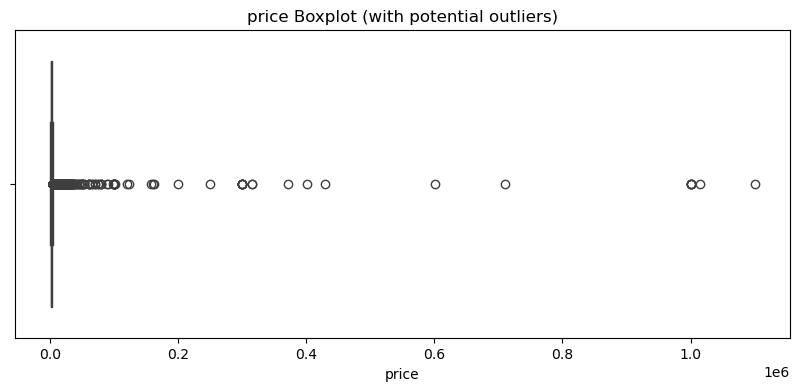


--- MINIMUM_NIGHTS ---
Lower Bound: -8.00
Upper Bound: 16.00
Outliers Detected: 3168 (19.99%)


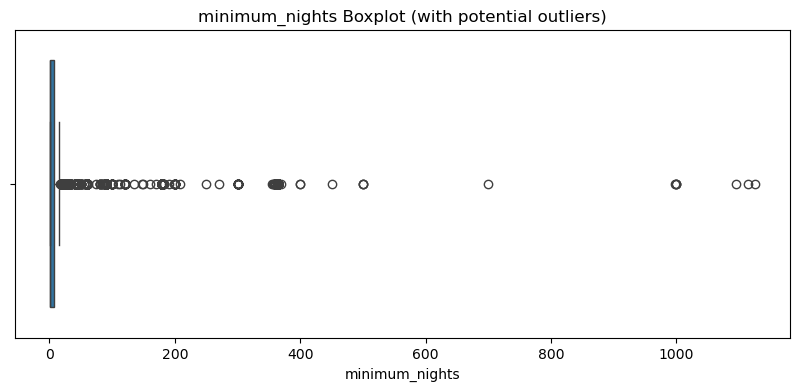


--- AVAILABILITY_365 ---
Lower Bound: -195.00
Upper Bound: 693.00
Outliers Detected: 0 (0.00%)


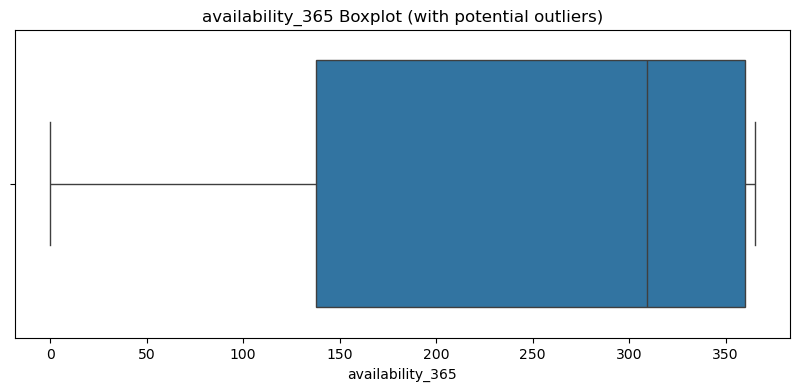

In [113]:
# Function to detect and return outliers using IQR
def detect_outliers_iqr(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = data[(data[column] < lower_bound) | (data[column] > upper_bound)]
    return outliers, lower_bound, upper_bound

# Columns to check
columns_to_check = ['price', 'minimum_nights', 'availability_365']

for col in columns_to_check:
    outliers, low, high = detect_outliers_iqr(df, col)
    print(f"\n--- {col.upper()} ---")
    print(f"Lower Bound: {low:.2f}")
    print(f"Upper Bound: {high:.2f}")
    print(f"Outliers Detected: {len(outliers)} ({(len(outliers)/len(df))*100:.2f}%)")
    
    # Optional: Plot
    plt.figure(figsize=(10, 4))
    sns.boxplot(x=df[col])
    plt.title(f'{col} Boxplot (with potential outliers)')
    plt.show()

### **Outlier detection for price**

In [116]:
# 1. Calculate Q1 and Q3 for price
q1_price = df['price'].quantile(0.25)
q3_price = df['price'].quantile(0.75)

# 2. Calculate IQR and determine fences
iqr_price = q3_price - q1_price
lower_fence_price = q1_price - 1.5 * iqr_price
upper_fence_price = q3_price + 1.5 * iqr_price

# 3. Identify outliers
outliers_price = df[(df['price'] < lower_fence_price) | (df['price'] > upper_fence_price)]
outliers_price_sorted = outliers_price.sort_values(by='price', ascending=False)

# 4. Count and percentage
count_outliers_price = outliers_price_sorted.shape[0]
percentage_outliers_price = (count_outliers_price / df.shape[0]) * 100

# 5. Show results
print(f"Q1: {q1_price}")
print(f"Q3: {q3_price}")
print(f"IQR: {iqr_price}")
print(f"Lower Fence: {lower_fence_price}")
print(f"Upper Fence: {upper_fence_price}")
print(f"Outlier Count: {count_outliers_price}")
print(f"Outlier Percentage: {percentage_outliers_price:.2f}%")

# 6. Show top 10 most expensive outliers
outliers_price_sorted[['id', 'name', 'price']].head(10)

Q1: 900.0
Q3: 2429.0
IQR: 1529.0
Lower Fence: -1393.5
Upper Fence: 4722.5
Outlier Count: 1402
Outlier Percentage: 8.85%


,id,name,price
12868,635676064543597376,New 1 bedroom apartment BTS MRT Asoke,1100000
12300,562972065309061724,3B中文No Guest Service Fee@Nana Asok/Soi11 Night...,1014758
6289,29909847,BTS轻轨线on nut站，全新一房一厅，临Tesco商场市集!New cozy 1BR,1000000
9345,39858231,1BR cozy condo close to ONNUT BTS.,1000000
1239,8880974,"Modern,wifi,5m MRT&2 Shopping Mall",1000000
1779,11579635,"2 Bedroom,wifi,5mMRT&Shopping Mall",1000000
4620,23740993,"Modern&Luxury apartment,5min to MRT,freeWifi",1000000
15200,766201549677186657,80米轻轨站，空中泳池+健身房，I con siam沙吞河景圈，距离大皇宫4公里，乳胶床垫,710760
4373,22633450,rm 1 : cozy & comfy,600700
11885,52940323,🎗𝘾𝙝𝙚𝙬𝙖𝙩𝙝𝙖𝙞 𝙍𝙖𝙢𝙠𝙝𝙖𝙢𝙝𝙖𝙚𝙣𝙜\nBy KhunGrape,429443


### **Price outliers visualization with Boxplot**

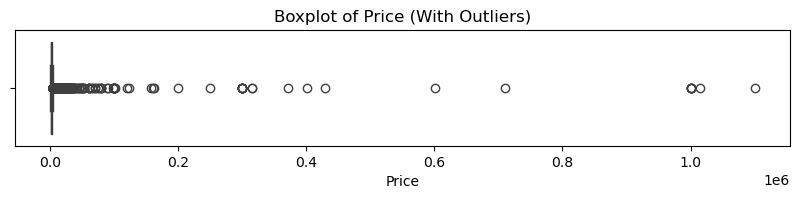

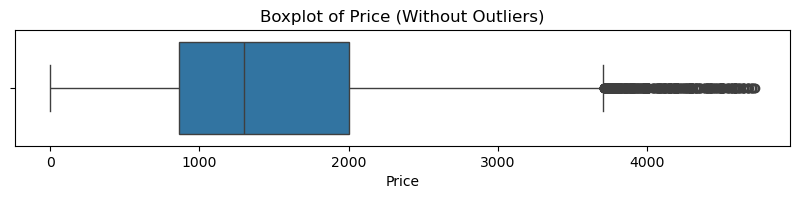

In [119]:
# Boxplot (with outliers)
plt.figure(figsize=(10, 1.5))
sns.boxplot(x=df['price'])
plt.title("Boxplot of Price (With Outliers)")
plt.xlabel("Price")
plt.show()

# Boxplot (without outliers)
df_no_outliers = df[(df['price'] >= lower_fence_price) & (df['price'] <= upper_fence_price)]
plt.figure(figsize=(10, 1.5))
sns.boxplot(x=df_no_outliers['price'])
plt.title("Boxplot of Price (Without Outliers)")
plt.xlabel("Price")
plt.show()

### **Outlier Detection for minimum_nights**

In [122]:
# 1. Q1, Q3, IQR
q1_min_nights = df['minimum_nights'].quantile(0.25)
q3_min_nights = df['minimum_nights'].quantile(0.75)
iqr_min_nights = q3_min_nights - q1_min_nights

# 2. Fences
lower_fence_min_nights = q1_min_nights - 1.5 * iqr_min_nights
upper_fence_min_nights = q3_min_nights + 1.5 * iqr_min_nights

# 3. Identify outliers
outliers_min_nights = df[(df['minimum_nights'] < lower_fence_min_nights) | (df['minimum_nights'] > upper_fence_min_nights)]
outliers_min_nights_sorted = outliers_min_nights.sort_values(by='minimum_nights', ascending=False)

# 4. Count and percentage
count_outliers_min_nights = outliers_min_nights.shape[0]
percentage_outliers_min_nights = (count_outliers_min_nights / df.shape[0]) * 100

# 5. Print summary
print("Minimum Nights Outliers")
print(f"Q1: {q1_min_nights}")
print(f"Q3: {q3_min_nights}")
print(f"IQR: {iqr_min_nights}")
print(f"Lower Fence: {lower_fence_min_nights}")
print(f"Upper Fence: {upper_fence_min_nights}")
print(f"Outlier Count: {count_outliers_min_nights}")
print(f"Outlier Percentage: {percentage_outliers_min_nights:.2f}%\n")
df_no_outliers_min_nights = df[(df['minimum_nights'] >= lower_fence_min_nights) & (df['minimum_nights'] <= upper_fence_min_nights)]

# 6. Show top 10 outliers
outliers_min_nights_sorted[['id', 'name', 'minimum_nights']].head(10)

Minimum Nights Outliers
Q1: 1.0
Q3: 7.0
IQR: 6.0
Lower Fence: -8.0
Upper Fence: 16.0
Outlier Count: 3168
Outlier Percentage: 19.99%



,id,name,minimum_nights
61,1041976,Long-stay special rate spacious entire floor Siam,1125
7986,35165443,Wonderful apartment for you holiday in Thai,1115
11524,49032568,Freehold Condo near Bangsue Grand Station,1095
10153,41623113,blossom condo舒适双床房摩天轮夜市周边免费泳池健身房@Sathon surasa...,1000
11243,45051929,Bellevue Boutique Bangkok | Airport Link HUA-MAK,999
10644,42685153,The Prime Sukhumvit 11 - Room 29/150,999
1200,8801560,"30th floor, 10 min to BTS, Seaview",998
1592,10709131,"34Fl 2, M Ladprao Condo,MRT & Malls",700
4194,22059876,C,500
3694,19893829,2 Bedroom Suite@Kirthana Residence,500


### **Mininum Nights outliers visualization with Boxplot**

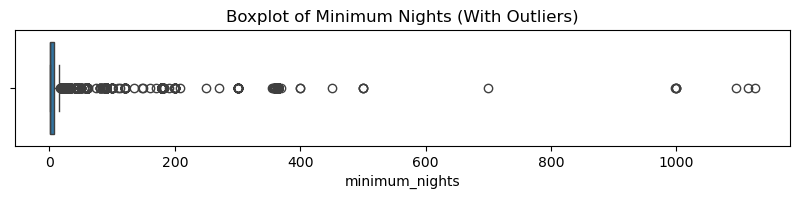

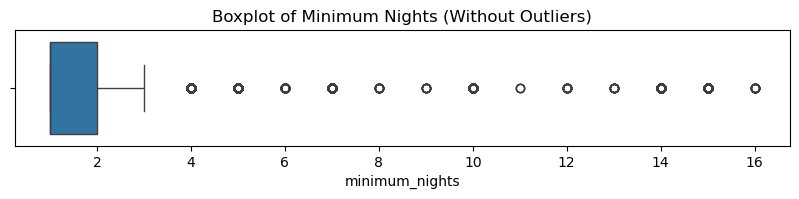

In [125]:
plt.figure(figsize=(10, 1.5))
sns.boxplot(x=df['minimum_nights'])
plt.title("Boxplot of Minimum Nights (With Outliers)")
plt.show()

plt.figure(figsize=(10, 1.5))
sns.boxplot(x=df_no_outliers_min_nights['minimum_nights'])
plt.title("Boxplot of Minimum Nights (Without Outliers)")
plt.show()

### **Outlier detection for Availability per year**

In [128]:
# 1. Q1, Q3, IQR
q1_avail = df['availability_365'].quantile(0.25)
q3_avail = df['availability_365'].quantile(0.75)
iqr_avail = q3_avail - q1_avail

# 2. Fences
lower_fence_avail = q1_avail - 1.5 * iqr_avail
upper_fence_avail = q3_avail + 1.5 * iqr_avail

# 3. Identify outliers
outliers_avail = df[(df['availability_365'] < lower_fence_avail) | (df['availability_365'] > upper_fence_avail)]
outliers_avail_sorted = outliers_avail.sort_values(by='availability_365', ascending=False)

# 4. Count and percentage
count_outliers_avail = outliers_avail.shape[0]
percentage_outliers_avail = (count_outliers_avail / df.shape[0]) * 100

# 5. Print summary
print("Availability_365 Outliers")
print(f"Q1: {q1_avail}")
print(f"Q3: {q3_avail}")
print(f"IQR: {iqr_avail}")
print(f"Lower Fence: {lower_fence_avail}")
print(f"Upper Fence: {upper_fence_avail}")
print(f"Outlier Count: {count_outliers_avail}")
print(f"Outlier Percentage: {percentage_outliers_avail:.2f}%\n")

# 6. Visualizations
df_no_outliers_avail = df[(df['availability_365'] >= lower_fence_avail) & (df['availability_365'] <= upper_fence_avail)]

Availability_365 Outliers
Q1: 138.0
Q3: 360.0
IQR: 222.0
Lower Fence: -195.0
Upper Fence: 693.0
Outlier Count: 0
Outlier Percentage: 0.00%



### **Availabilty per year outliers visualization with Boxplot**

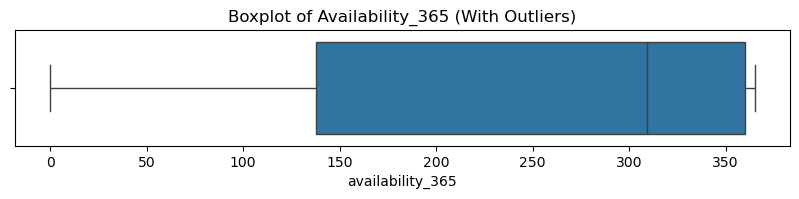

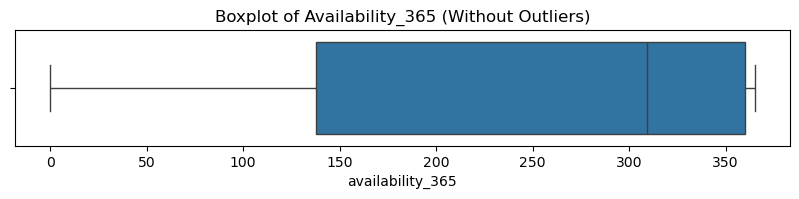

In [131]:
plt.figure(figsize=(10, 1.5))
sns.boxplot(x=df['availability_365'])
plt.title("Boxplot of Availability_365 (With Outliers)")
plt.show()

plt.figure(figsize=(10, 1.5))
sns.boxplot(x=df_no_outliers_avail['availability_365'])
plt.title("Boxplot of Availability_365 (Without Outliers)")
plt.show()

### **Counting most likely listings to be inactive under 30 days availability**

In [134]:
df['likely_inactive'] = df['availability_365'] < 30
df['likely_inactive'].value_counts()

likely_inactive
False    14716
True      1129
Name: count, dtype: int64

### **Dropping outliers for `price`**  

In [137]:
# Calculate upper fence for 'price'
Q1_price = df['price'].quantile(0.25)
Q3_price = df['price'].quantile(0.75)
IQR_price = Q3_price - Q1_price
upper_fence_price = Q3_price + 1.5 * IQR_price

# Filter out price outliers (above upper fence)
df = df[df['price'] <= upper_fence_price]

# Check results
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14443 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              14443 non-null  int64         
 1   name                            14443 non-null  object        
 2   host_id                         14443 non-null  int64         
 3   host_name                       14443 non-null  object        
 4   neighbourhood                   14443 non-null  object        
 5   latitude                        14443 non-null  float64       
 6   longitude                       14443 non-null  float64       
 7   room_type                       14443 non-null  object        
 8   price                           14443 non-null  int64         
 9   minimum_nights                  14443 non-null  int64         
 10  number_of_reviews               14443 non-null  int64         
 11  last_re

### **Dropping outliers for `minimum_nights`**

In [140]:
df = df[df['minimum_nights'] <= 365]

# Check results
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14433 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              14433 non-null  int64         
 1   name                            14433 non-null  object        
 2   host_id                         14433 non-null  int64         
 3   host_name                       14433 non-null  object        
 4   neighbourhood                   14433 non-null  object        
 5   latitude                        14433 non-null  float64       
 6   longitude                       14433 non-null  float64       
 7   room_type                       14433 non-null  object        
 8   price                           14433 non-null  int64         
 9   minimum_nights                  14433 non-null  int64         
 10  number_of_reviews               14433 non-null  int64         
 11  last_re

### **Check and drop whether there is '0' in price row**

In [143]:
zero_price_data = df[df['price'] == 0]
zero_price_data

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,likely_inactive
11103,44563108,Somerset Maison Asoke Bangkok,360620448,Somerset Maison Asoke,Vadhana,13.73815,100.5642,Hotel room,0,1,0,NaT,0.0,1,0,0,True


In [145]:
# Drop rows where price is 0
df = df[df['price'] > 0]

# Optional: reset index
df.reset_index(drop=True, inplace=True)

# Check result
print("Row after removing price == 0:", df.shape)

Row after removing price == 0: (14432, 17)


### **Dataset final check before moving on to analysis**

In [148]:
# Showing how many listings each host has
df[['host_id', 'host_name']].value_counts()

host_id    host_name
201677068  Curry        221
52161947   Noons         97
26736483   K             75
228535635  Pornchai      62
62257044   Ludoping      54
                       ... 
74797321   Varaporn       1
74780443   Attapol        1
74607170   Mana           1
74413809   นวลปรางค์      1
492665929  Ana Elena      1
Name: count, Length: 6188, dtype: int64

In [150]:
# Count of unique hosts per area
hosts_per_area = df.groupby('neighbourhood')['host_id'].nunique().sort_values(ascending=False).reset_index(name='unique_hosts')
hosts_per_area

,neighbourhood,unique_hosts
0,Vadhana,916
1,Khlong Toei,742
2,Huai Khwang,471
3,Ratchathewi,364
4,Chatu Chak,351
5,Phra Khanong,334
6,Bang Rak,286
7,Bang Na,282
8,Sathon,244
9,Suanluang,244


### **Active hosts per area in the past 3 years**

In [153]:
# Filter active hosts with reviews between 2020 and 2022
active_hosts = df[df['last_review'].dt.year.between(2020, 2022)]

# Group by neighbourhood and count unique active hosts
active_hosts_per_area = (
    active_hosts.groupby('neighbourhood')['host_id']
    .nunique()
    .sort_values(ascending=False)
    .reset_index(name='active_hosts')
)

active_hosts_per_area

,neighbourhood,active_hosts
0,Vadhana,486
1,Khlong Toei,452
2,Huai Khwang,212
3,Ratchathewi,200
4,Bang Rak,163
5,Phra Khanong,155
6,Sathon,136
7,Chatu Chak,133
8,Bang Na,129
9,Din Daeng,116


In [155]:
listing_type_area = df.groupby(['neighbourhood', 'room_type']).size().reset_index(name='count')
listing_type_area = listing_type_area.sort_values(by='count', ascending=False)
listing_type_area

,neighbourhood,room_type,count
74,Khlong Toei,Entire home/apt,1392
156,Vadhana,Entire home/apt,1195
62,Huai Khwang,Entire home/apt,720
124,Ratchathewi,Entire home/apt,631
137,Sathon,Entire home/apt,527
158,Vadhana,Private room,444
76,Khlong Toei,Private room,419
112,Phra Nakhon,Private room,338
29,Bang Rak,Private room,331
106,Phra Khanong,Entire home/apt,324


In [157]:
listing_type_pivot = listing_type_area.pivot(index='neighbourhood', columns='room_type', values='count').fillna(0)
listing_type_pivot

room_type,Entire home/apt,Hotel room,Private room,Shared room
neighbourhood,,,,
Bang Bon,2.0,0.0,3.0,0.0
Bang Kapi,117.0,1.0,128.0,3.0
Bang Khae,35.0,1.0,50.0,0.0
Bang Khen,48.0,3.0,61.0,1.0
Bang Kho laen,89.0,1.0,34.0,0.0
Bang Khun thain,4.0,0.0,12.0,1.0
Bang Na,261.0,8.0,156.0,3.0
Bang Phlat,126.0,3.0,69.0,6.0
Bang Rak,308.0,65.0,331.0,34.0


In [159]:
# Add a total count column to sort
listing_type_pivot['total'] = listing_type_pivot.sum(axis=1)

# Sort by total in descending order
listing_type_pivot_sorted = listing_type_pivot.sort_values(by='total', ascending=False)

listing_type_pivot_sorted

room_type,Entire home/apt,Hotel room,Private room,Shared room,total
neighbourhood,,,,,
Khlong Toei,1392.0,59.0,419.0,15.0,1885.0
Vadhana,1195.0,76.0,444.0,53.0,1768.0
Ratchathewi,631.0,61.0,308.0,58.0,1058.0
Huai Khwang,720.0,18.0,270.0,23.0,1031.0
Sathon,527.0,13.0,204.0,17.0,761.0
Bang Rak,308.0,65.0,331.0,34.0,738.0
Phra Nakhon,50.0,68.0,338.0,129.0,585.0
Phra Khanong,324.0,9.0,195.0,11.0,539.0
Chatu Chak,254.0,1.0,259.0,7.0,521.0


In [161]:
# Step 1: Filter out invalid or default 'last_review' dates (e.g., before 2012)
valid_df = df[df['last_review'] >= '2012-01-01'].copy()

# Step 2: Group to find earliest and latest review dates per host (from valid reviews only)
host_activity = valid_df.groupby('host_id')['last_review'].agg(['min', 'max']).reset_index()

# Step 3: Calculate number of years active
host_activity['years_active'] = (host_activity['max'] - host_activity['min']).dt.days / 365

# Step 4: Merge back with main dataframe to get neighbourhood info
host_years = pd.merge(
    valid_df[['host_id', 'neighbourhood']],
    host_activity[['host_id', 'years_active']],
    on='host_id'
).drop_duplicates()

# Step 5: Group by neighbourhood to calculate average host activity duration
avg_years_area = host_years.groupby('neighbourhood')['years_active'].mean().sort_values(ascending=False).reset_index()

# Show result
avg_years_area

,neighbourhood,years_active
0,Samphanthawong,1.239890
1,Pom Prap Sattru Phai,1.154697
2,Phra Nakhon,1.101526
3,Khlong San,1.006476
4,Khan Na Yao,0.933881
5,Bangkok Yai,0.922855
6,Bang Kho laen,0.921537
7,Pra Wet,0.914467
8,Bang Rak,0.908376
9,Suanluang,0.902684


In [163]:
# Group by neighbourhood to get average host activity duration
avg_years_area = (
    host_years.groupby('neighbourhood')['years_active']
    .mean()
    .round(2)  # Round to 2 decimal places
    .sort_values(ascending=False)
    .reset_index()
)

avg_years_area

,neighbourhood,years_active
0,Samphanthawong,1.24
1,Pom Prap Sattru Phai,1.15
2,Phra Nakhon,1.10
3,Khlong San,1.01
4,Khan Na Yao,0.93
5,Bang Kho laen,0.92
6,Bangkok Yai,0.92
7,Bang Rak,0.91
8,Pra Wet,0.91
9,Suanluang,0.90


## **Explanatory Data Analysis**

We have completed the data cleaning stage for the Airbnb dataset in Bangkok, which consists a total of **14,432 rows and 17 columns**. Now, we can begin analyzing the data to understand **the characteristics of hosts and listings across different neighborhoods in Bangkok**.

The analysis will focus on comparisons based on neighborhood, room type, and host activity such as active duration and number of reviews. Since the data distribution is not uniform (e.g., many listings lack recent reviews or have extreme minimum night values), results should be interpreted with care. Using ratios or averages—especially for categorical variables—will help ensure the analysis remains meaningful and representative.

## 1. What is the most common minimum night requirement among listings, and how does it affect the number of reviews?

### Keeping only relevant columns

In [187]:
print("avg_reviews_by_min_nights columns:", avg_reviews_by_min_nights.columns.tolist())
print("min_night_counts columns:", min_night_counts.columns.tolist())

avg_reviews_by_min_nights columns: ['minimum_nights', 'number_of_reviews']
min_night_counts columns: ['minimum_nights', 'listing_count']


### Keep relevant columns and remove missing data

In [172]:
min_nights_df = df[['minimum_nights', 'number_of_reviews']].copy()
min_nights_df.dropna(inplace=True)

### Calculate average reviews by minimum nights

In [175]:
most_common_min_nights = min_nights_df['minimum_nights'].mode()[0]
print("Most common minimum night requirement:", most_common_min_nights)

Most common minimum night requirement: 1


In [177]:
avg_reviews_by_min_nights = (
    min_nights_df.groupby('minimum_nights')['number_of_reviews']
    .mean()
    .round(2)
    .reset_index()
)

### Count listings per minimum_nights 

In [180]:
min_night_counts = (
    min_nights_df['minimum_nights']
    .value_counts()
    .reset_index()
    .rename(columns={'index': 'minimum_nights', 'count': 'listing_count'})
)

# Step 5: Merge datasets
merged_data = avg_reviews_by_min_nights.merge(min_night_counts, on='minimum_nights')

# Step 6: Filter data
filtered_data = merged_data[
    (merged_data['minimum_nights'] <= 30) & (merged_data['listing_count'] >= 10)
]

### **Data Visualization**

In [183]:
# Step 7: Visualize
plt.figure(figsize=(12, 6))
sns.scatter(data=filtered_data, x='minimum_nights', y='number_of_reviews', marker='o')
plt.title('Average Number of Reviews vs. Minimum Night Requirement (1–30 nights)')
plt.xlabel('Minimum Nights')
plt.ylabel('Average Number of Reviews')
plt.grid(True)
plt.show()

AttributeError: module 'seaborn' has no attribute 'scatter'

<Figure size 1200x600 with 0 Axes>

In [185]:
filtered_data.sort_values(by='number_of_reviews', ascending=False).head(10)

,minimum_nights,number_of_reviews,listing_count
15,16,59.81,21
7,8,36.88,16
1,2,25.52,1549
3,4,24.61,171
2,3,19.85,905
27,28,18.58,529
19,20,17.66,110
13,14,17.27,188
0,1,17.06,7333
4,5,16.43,394


## Insights:  
1. **Outlier at 15–16 Nights:**  
   - Exceptionally high average reviews (**59.81**) but only **21 listings**.  
   - Likely niche properties (e.g., premium/long-term rentals) or data anomalies.  

2. **Peak Performance at 2–4 Nights:**  
   - **2-night stays** lead with **25.52 avg reviews**, followed by **4-night (24.61)** and **3-night (19.85)**.  
   - Ideal balance for short, flexible trips.  

3. **Shortest Stays (1 Night):**  
   - Most common (**7,333 listings**) but lower engagement (**17.06 avg reviews**).  
   - Suggests guests prefer slightly longer stays for better experiences.  

4. **Decline Beyond 4 Nights:**  
   - Sharp drop in reviews for **5+ nights** (e.g., 5-night: **16.43**).  
   - Indicates alignment with typical tourist preferences for short stays.  

5. **28-Night Stays:**  
   - Moderate engagement (**18.58 reviews**) with **529 listings**.  
   - Reflects steady demand for monthly stays (digital nomads/expats). 

**Summary:**

While 1 night listings dominate in volume, setting a minimum stay of 2 to 4 nights appears to optimize for guest satisfaction and higher review activity, a valuable strategy for hosts aiming to attract more bookings and feedback.

### Prepare the Data

In [ ]:
# Keep only relevant columns
roomtype_df = df[['room_type', 'price', 'number_of_reviews']].copy()

# Drop rows with missing values
roomtype_df.dropna(inplace=True)

# Confirm data looks good
roomtype_df.head()

In [ ]:
print(df.columns.tolist())

### Calculate Averages

In [ ]:
# Group by room_type and calculate mean for price and reviews
avg_by_room_type = (
    roomtype_df.groupby('room_type')[['price', 'number_of_reviews']]
    .mean()
    .round(2)
    .reset_index()
)

# Preview the result
avg_by_room_type

### Data Visualization

#### Bar Plot: Average Price by Room Type

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set plot style
sns.set(style="whitegrid")

plt.figure(figsize=(10, 5))
sns.barplot(data=avg_by_room_type, x='room_type', y='price', palette='viridis')
plt.title('Average Price by Room Type')
plt.ylabel('Average Price (USD)')
plt.xlabel('Room Type')
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()

#### Bar Plot: Average Reviews by Room Type

In [ ]:
plt.figure(figsize=(10, 5))
sns.barplot(data=avg_by_room_type, x='room_type', y='number_of_reviews', palette='coolwarm')
plt.title('Average Number of Reviews by Room Type')
plt.ylabel('Average Reviews')
plt.xlabel('Room Type')
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()

In [ ]:
roomtype_summary = (
    roomtype_df
    .groupby('room_type')
    .agg(avg_price=('price', 'mean'), avg_reviews=('number_of_reviews', 'mean'))
    .round(2)
    .reset_index()
)

print("Room Type Summary:")
print(roomtype_summary)

## Insights:

### **Price and Review Trends:**  
1. **Entire Home/Apartment Listings Dominate:**  
   - **Highest Average Price**: ₹1,705.79 (USD ~1705.79)  
   - **Highest Average Reviews**: 22.60 reviews  
   - Indicates strong demand for privacy and space, likely appealing to families or longer-stay guests.
     
2. **Hotel Rooms Compete Closely:**  
   - Slightly lower average price than entire homes (₹1,691.23) but similar review count (21.87).  
   - Suggests guests value hotel-like amenities (e.g., professional service, consistency) in private settings.

3. **Private Rooms Lag in Engagement:**  
   - Lower average price (₹1,422.45) and significantly fewer reviews (9.27).  
   - Despite affordability, they may lack appeal due to limited privacy or perceived value.

4. **Shared Rooms Have Minimal Impact:**  
   - Cheapest option (₹639.34) but lowest reviews (5.18).  
   - Likely attracts budget travelers who prioritize cost over comfort, resulting in lower engagement.  

### **Key Observations from the Data:**  
- **Price-Review Correlation**: Higher-priced room types (entire homes, hotel rooms) receive **2–4x more reviews** than cheaper options.  
- **Guest Preferences**: Travelers in Bangkok prioritize privacy and quality over affordability, as seen in the popularity of entire homes and hotel rooms.  
- **Outliers in Private Rooms**: Some private rooms (e.g., ₹1,905 priced listings) have **0 reviews**, hinting at potential issues like overpricing, poor quality, or inactive listings.

# Airbnb Bangkok Listing Analysis – Summary of Findings

## 1. Minimum-Stay Patterns

Bangkok Airbnb data show one-night minimums are by far most common, but slightly longer stays drive higher engagement.  

- Listings requiring 2–4 nights see the highest average number of reviews (peaking at ~25.5 reviews for a 2-night minimum), while 1-night listings – though most numerous – average only ~17 reviews.
- Very long minimums (e.g. 15–16 nights) yield very high review counts (~60) but involve few listings, indicating niche markets.
- Monthly (28-night) rentals also maintain moderate review levels (~18) with steady demand.

**Insight:** Moderate minimum stays (2–4 nights) strike the best balance: they cater to typical tourist trips, boost occupancy, and lead to better guest satisfaction.

## 2. Room-Type Pricing & Reviews

Entire-home/apartment listings command the highest prices and guest engagement, followed closely by private “hotel room” listings.

- **Entire-home listings:** highest prices (1,705) and most reviews (22).
- **Hotel-room style:** slightly lower price (1,691) and reviews (21).
- **Private rooms:** lower price (1,422), fewer reviews (9).
- **Shared rooms:** cheapest (639), lowest reviews (5).

**Insight:** Price and review counts rise with listing size/privacy. Full-unit rentals attract more paying guests and garner more feedback.

# Airbnb Bangkok Listing Analysis – Recommendations

## Strategic Recommendations – For Bangkok Hosts

- Set minimum stay to 2–3 nights to improve occupancy and review count.
- Prioritize listing entire-home units when possible to maximize engagement.
- Enhance competitiveness of private/shared rooms with better amenities or pricing.
- Actively collect and respond to guest feedback to increase review volume and boost search visibility.

## Strategic Recommendations – For Airbnb & Local Tourism Stakeholders

- Use data to recommend 2–3 night minimums in host settings and guidance.
- Promote entire-home listings in Bangkok and offer dynamic pricing tools.
- Align campaigns with mid-length visitors (2–4 night or 28-night stays).
- Support hosts of budget/private/shared rooms through training, co-marketing, or certification to boost appeal and trust.

# THANK YOU